# Exploratory Data Analysis (EDA)

## Introduction

In this notebook, we will highlight the key findings of the V4 version of the data that was provided to us by TeejLab.

This was conducted in two parts - (1) before feature engineering and processing and (2) after feature engineering and processing.

**Conclusions from this notebook:**

- There is a heavy imbalance of risk labels in this dataset. Out of 1886 rows of data, 4 of which is labeled as *High Risk*, 985 as *Medium Risk*, and 892 as *Low Risk*. As such, our team will be employing a data augmentation technique, **synthetic minority oversampling technique** (SMOTE) in the training set in our scripts.
- There are many empty data points for a few columns, namely "security_test_category", "server_location", "usage_base". As such, imputation techniques were carried out.
- As there were 13 categorical variables, and 3 of which were text, we employed feature engineering techniques. These can be observed in Part 2 of the EDA.

## Imports

In [1]:
import pandas as pd
import numpy as np
import openpyxl
from matplotlib import pyplot as plt
import spacy
import warnings
warnings.filterwarnings("ignore")
import altair as alt
alt.renderers.enable('mimetype')

RendererRegistry.enable('mimetype')

## Read in data

### Read in Risk Classification Excel file

In [2]:
# note that the raw data file is not present in the raw data sub folder due to NDA agreement. Please refer to email for the dataset. 
api_df = pd.read_excel("../../data/raw/RiskClassification_Data_Endpoints_V4_Shared1.xlsx", 
                       "Core_Endpoint",
                       usecols="A:R")
api_df.head()

,api_endpoint_id,api_id,api_vendor_id,request_id,method,category,parameters,usage_base,sample_response,tagset,authentication,security_test_category,security_test_result (FALSE=Passed; TRUE=Failed),server_location,hosting_isp,server_name,response_metadata,hosting_city
0,1,1,1,23688,get,Environment & Weather,"{""q"": ""Vancouver"", ""mode"": ""JSON"", ""type"": ""ac...",NaN,"{""coord"":{""lon"":-123.1193,""lat"":49.2497},""weat...","cod,temp,icon,speed,name,sunrise,clouds,all,de...",query,NaN,NaN,United States,"DigitalOcean, LLC",openresty,"{""Date"": ""Mon, 23 Aug 2021 19:49:39 GMT"", ""Ser...",New York
1,2,2,2,23597,get,Information & Science,"{""q"": ""hello world""}",NaN,"{\n ""kind"": ""books#volumes"",\n ""totalItems"":...","averageRating,panelizationSummary,webReaderLin...",query,NaN,NaN,Canada,Google LLC,ESF,"{""Date"": ""Fri, 30 Jul 2021 21:48:43 GMT"", ""Var...",Montreal
2,2,2,2,23597,get,Information & Science,"{""q"": ""hello world""}",NaN,"{\n ""kind"": ""books#volumes"",\n ""totalItems"":...","averageRating,panelizationSummary,webReaderLin...",query,NaN,NaN,Canada,Google LLC,ESF,"{""Date"": ""Fri, 30 Jul 2021 21:48:43 GMT"", ""Var...",Toronto
3,2,2,2,23597,get,Information & Science,"{""q"": ""hello world""}",NaN,"{\n ""kind"": ""books#volumes"",\n ""totalItems"":...","averageRating,panelizationSummary,webReaderLin...",query,NaN,NaN,Canada,Google LLC,GSE,"{""Date"": ""Fri, 30 Jul 2021 21:48:43 GMT"", ""Var...",Montreal
4,2,2,2,23597,get,Information & Science,"{""q"": ""hello world""}",NaN,"{\n ""kind"": ""books#volumes"",\n ""totalItems"":...","averageRating,panelizationSummary,webReaderLin...",query,NaN,NaN,Canada,Google LLC,GSE,"{""Date"": ""Fri, 30 Jul 2021 21:48:43 GMT"", ""Var...",Toronto


### Read in preprocessed data (inclusive of risk labels + transformed columns)

In [3]:
train_df = pd.read_excel("../../data/processed/preprocessed_train.xlsx", usecols="A:BA")
api_preprocessed_df = pd.read_excel("../../data/processed/preprocessed_all.xlsx", usecols="A:BA")

Note that this is not a common process in EDA. However, due to the lack of risk labels, and the need to show our findings in terms of the distribution of data, I have included the preprocessed dataset.

## 1. Understanding the data

#### Number of rows of data

In [4]:
api_df["api_endpoint_id"].count()

1886

#### Type of data in each column

In [5]:
api_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1886 entries, 0 to 1885
Data columns (total 18 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   api_endpoint_id                                   1886 non-null   int64  
 1   api_id                                            1886 non-null   int64  
 2   api_vendor_id                                     1886 non-null   int64  
 3   request_id                                        1886 non-null   int64  
 4   method                                            1886 non-null   object 
 5   category                                          1886 non-null   object 
 6   parameters                                        1886 non-null   object 
 7   usage_base                                        79 non-null     object 
 8   sample_response                                   1875 non-null   object 
 9   tagset             

As seen from above, there are 13 categorical, 1 numeric column (this is excluding the id columns). As such, this indicates that there is a need for preprocessing and feature engineering techniques to use the existing data while also extracting other information from the text columns (sample_response, parameters, response_metadata).

#### Distribution of Risk Labels

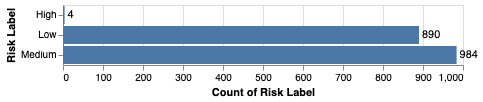

In [6]:
risk_label_chart = alt.Chart(api_preprocessed_df).mark_bar().encode(
    x=alt.X('count(Risk_Label)', axis=alt.Axis(title = 'Count of Risk Label')),
    y=alt.Y('Risk_Label', axis=alt.Axis(title = 'Risk Label'))
)

text = risk_label_chart.mark_text(
    align='left',
    baseline='middle',
    dx=3
).encode(
    text = 'count(Risk_Label)'
)

(risk_label_chart+text)

As seen from this chart, it is obvious that there is a class imbalance in the dataset, where there are similar counts of Low and Medium Risk, but only 4 counts of High Risk Labels.

Thus, this is a clear indication that there needs to be some data augmentation required.

#### Number of unique values in the categorical columns

In [7]:
api_df[["method", "category", "usage_base", "authentication", 
        "security_test_category", "server_location", "hosting_isp",
        "server_name", "hosting_city"]].nunique()

method                     4
category                  24
usage_base                 3
authentication             8
security_test_category     5
server_location           16
hosting_isp               68
server_name               68
hosting_city              79
dtype: int64

#### Distribution of categorical columns

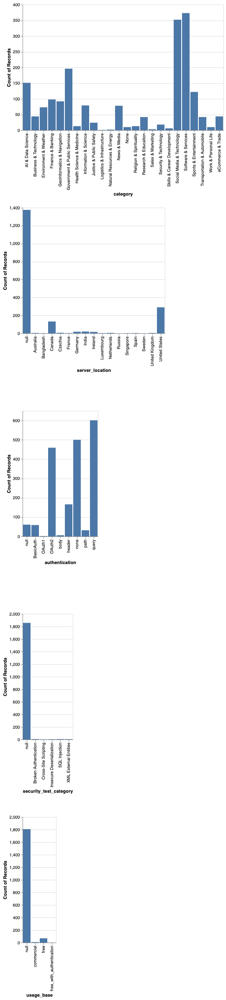

In [8]:
alt.Chart(api_df).mark_bar().encode(
    x=alt.X(alt.repeat('repeat')),
    y='count()'
).repeat(
    repeat=["category", "server_location", "authentication", 
        "security_test_category", "usage_base"],
    columns=1
)

**From these charts, the following are key observations (not all charts will be commented on).** 

(1) Most of the categories that TeejLab has in their interface is present in this dataset, albeit spares for some categories, namely "Logistics and Infrastructure", "Natural Resources and Energy", "Sales and Marketing", and "Skills and Career Development".   
(2) For the server_location, most server location information is missing.  
(3) For the security test category, as aware, there are many rows with not a single test conducted.   
(4) For the usage base, there are also many rows this this information not available.

<hr>

### 2. Understanding the data further

We will only use the train dataset from here onwards.

In [9]:
train_df.head()

,is_pii,is_fii,NRI score,authentication_processed,usage_base_processed,AI & Data Science,Business & Technology,Environment & Weather,Finance & Banking,GeoInformatics & Navigation,...,content-type,set-cookie,access-control-allow-origin,server,x-powered-by,x-aspnet-version,x-ratelimit-limit,metadata_fields_count,parameters_count,Risk_Label
0,True,False,77.850013,0,2,0,0,0,0,0,...,0,0,0,0,0,0,0,2,2,Low
1,True,False,77.850013,1,2,0,0,0,0,0,...,0,0,0,1,0,0,0,6,1,Low
2,False,False,76.479613,1,2,0,1,0,0,0,...,0,0,0,1,0,0,0,3,1,Medium
3,True,False,76.479613,1,2,0,0,0,0,0,...,1,0,0,0,0,0,0,5,0,Low
4,True,False,77.850013,0,2,0,0,0,0,0,...,0,0,0,0,0,0,0,2,3,Low


#### Distribution of PII and FII

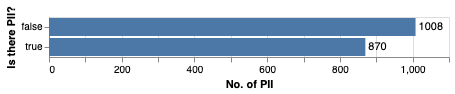

In [10]:
pii = alt.Chart(api_preprocessed_df).mark_bar().encode(
    x=alt.X('count(is_pii)', axis=alt.Axis(title = 'No. of PII')),
    y=alt.Y('is_pii', axis=alt.Axis(title = 'Is there PII?')))

text = pii.mark_text(
    align='left',
    baseline='middle',
    dx=3
).encode(
    text = 'count()'
)

(pii+text)

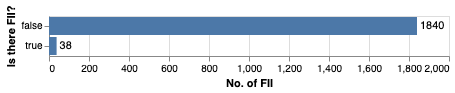

In [11]:
fii = alt.Chart(api_preprocessed_df).mark_bar().encode(
    x=alt.X('count(is_fii)', axis=alt.Axis(title = 'No. of FII')),
    y=alt.Y('is_fii', axis=alt.Axis(title = 'Is there FII?')))

text = fii.mark_text(
    align='left',
    baseline='middle',
    dx=3
).encode(
    text = 'count()'
)

(fii+text)

#### Distribution of metadata_fields_count

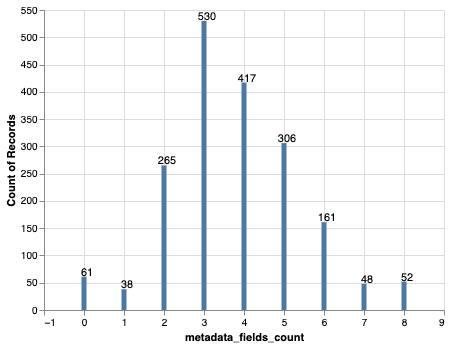

In [12]:
mfc = alt.Chart(api_preprocessed_df).mark_bar().encode(
    x='metadata_fields_count',
    y='count(metadata_fields_count)')

text = mfc.mark_text(
    align='center',
    baseline='middle',
    dx=3,
    dy=-4
).encode(
    text = 'count()'
)

(mfc+text)

#### Distribution of parameters_count

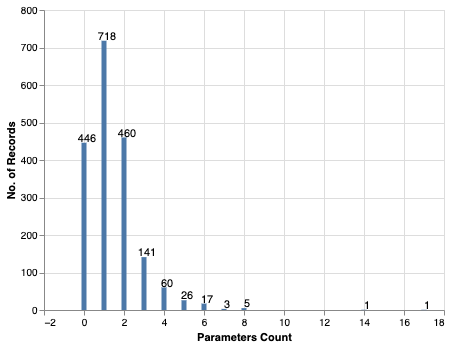

In [13]:
pc = alt.Chart(api_preprocessed_df).mark_bar().encode(
    x=alt.X('parameters_count', axis=alt.Axis(title = 'Parameters Count')),
    y=alt.Y('count(parameters_count)', axis=alt.Axis(title = 'No. of Records'))
    )

text = pc.mark_text(
    align='center',
    baseline='middle',
    dx=3,
    dy=-4
).encode(
    text = 'count()'
)

(pc+text)